In [100]:
import sympy as sp
import numpy as np
import matplotlib.pyplot as plt
from sympy.utilities import lambdify
from matplotlib.animation import FuncAnimation
from IPython.display import HTML

sp.init_printing()

In [101]:
x = sp.Symbol('x', real = True)
k = sp.Symbol('k', real = True, positive = True)
a = sp.Symbol('a', real = True)
fop = sp.Symbol('fop')
fopsquare = sp.Symbol('fopsquare')
m = sp.Symbol('m', real = True, positive = True)
h = sp.Symbol('hbar', real = True, positive = True)
t = sp.Symbol('t', real = True, positive = True)
psi = sp.Function('\psi')
n = sp.Symbol('n', integer = True)

x, k, a, psi(x), n, m, h, t

c:\Users\peter\anaconda3\lib\site-packages\IPython\lib\latextools.py:126: MatplotlibDeprecationWarning: 
The to_png function was deprecated in Matplotlib 3.4 and will be removed two minor releases later. Use mathtext.math_to_image instead.
  mt.to_png(f, s, fontsize=12, dpi=dpi, color=color)
c:\Users\peter\anaconda3\lib\site-packages\IPython\lib\latextools.py:126: MatplotlibDeprecationWarning: 
The to_rgba function was deprecated in Matplotlib 3.4 and will be removed two minor releases later. Use mathtext.math_to_image instead.
  mt.to_png(f, s, fontsize=12, dpi=dpi, color=color)
c:\Users\peter\anaconda3\lib\site-packages\IPython\lib\latextools.py:126: MatplotlibDeprecationWarning: 
The to_mask function was deprecated in Matplotlib 3.4 and will be removed two minor releases later. Use mathtext.math_to_image instead.
  mt.to_png(f, s, fontsize=12, dpi=dpi, color=color)
c:\Users\peter\anaconda3\lib\site-packages\IPython\lib\latextools.py:126: MatplotlibDeprecationWarning: 
The MathtextBa

In [102]:
psi(x).diff(x, x)
-k**2 * psi(x)
eq = sp.Eq(psi(x).diff(x, x), -k**2 * psi(x))
eq
sol = sp.dsolve(eq, psi(x), ics = {psi(0): 0, psi(a): 0})
sol 

In [103]:
sol = sp.dsolve(eq, psi(x), ics = {psi(0): 0})
sol 


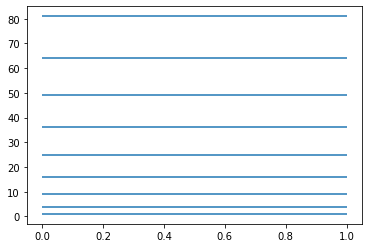

In [104]:
plt.hlines(np.arange(1, 10)**2, 0, 1)

In [105]:
sol = sol.subs(k, n * sp.pi / a)
sol

In [106]:
sol.lhs, sol.rhs

In [107]:
sol.rhs**2

In [108]:
sp.integrate(sol.rhs**2, (x, 0, a))

⎧  2               
⎪C₁ ⋅a      π⋅n    
⎪─────  for ─── ≠ 0
⎨  2         a     
⎪                  
⎪  0     otherwise 
⎩                  

In [109]:
sp.Symbol('C1')

In [110]:
sol = sol.subs(sp.Symbol('C1'), sp.sqrt(2 / a))
sol

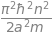

In [111]:
E = n**2 * sp.pi**2 * h**2 / (2 * m * a**2)
E

In [112]:
phi = sp.exp(-sp.I * E * t / h)
phi

In [113]:
Psi = sol.rhs * phi
Psi

In [114]:
Psi.subs({a: 1, h: 1, m: 1})

In [115]:
Psif = lambdify((x, t, n), Psi.subs({a: 1, h: 1, m: 1}))

In [116]:
Psif(0.3, 0.2, 1), Psif(0.3, 0.2, 1).real, Psif(0.3, 0.2, 1).imag

((0.6306730671332264-0.9546038323659279j),
 0.6306730671332264,
 -0.9546038323659279)

In [117]:
xs = np.linspace(0, 1, 100)
Psif(xs, 0.2, 1)

array([0.00000000e+00+0.00000000e+00j, 2.47336623e-02-3.74375410e-02j,
       4.94424199e-02-7.48373856e-02j, 7.41013932e-02-1.12161875e-01j,
       9.86857526e-02-1.49373427e-01j, 1.23170744e-01-1.86434573e-01j,
       1.47531713e-01-2.23307995e-01j, 1.71744129e-01-2.59956565e-01j,
       1.95783615e-01-2.96343381e-01j, 2.19625962e-01-3.32431803e-01j,
       2.43247165e-01-3.68185496e-01j, 2.66623438e-01-4.03568456e-01j,
       2.89731245e-01-4.38545058e-01j, 3.12547316e-01-4.73080081e-01j,
       3.35048679e-01-5.07138754e-01j, 3.57212677e-01-5.40686780e-01j,
       3.79016991e-01-5.73690381e-01j, 4.00439667e-01-6.06116324e-01j,
       4.21459135e-01-6.37931959e-01j, 4.42054229e-01-6.69105251e-01j,
       4.62204212e-01-6.99604811e-01j, 4.81888794e-01-7.29399928e-01j,
       5.01088155e-01-7.58460601e-01j, 5.19782963e-01-7.86757568e-01j,
       5.37954394e-01-8.14262338e-01j, 5.55584150e-01-8.40947214e-01j,
       5.72654480e-01-8.66785327e-01j, 5.89148195e-01-8.91750662e-01j,
      

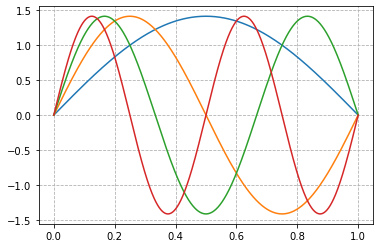

In [118]:
xs = np.linspace(0, 1, 1000)

plt.grid(linestyle = '--')

plt.plot(xs, Psif(xs, 0, 1).real)
plt.plot(xs, Psif(xs, 0, 2).real)
plt.plot(xs, Psif(xs, 0, 3).real)
plt.plot(xs, Psif(xs, 0, 4).real)

In [119]:
n = 5
xs = np.linspace(0, 1, 1000)
fig = plt.figure()
plt.grid(linestyle = '--')

plot1, = plt.plot([], [])
plot2, = plt.plot([], [])
plt.xlim(0, 1)
plt.ylim(-1.5, 1.5)

plt.close()
dt = 0.001
def frame(i):
    t = i * dt
    ys = Psif(xs, t, n)
    plot1.set_data(xs, ys.real)
    plot2.set_data(xs, ys.imag)
    return plot1, plot2

anim = FuncAnimation(fig, frame, 300, interval = 20, blit = True)
HTML(anim.to_jshtml())


In [120]:
n = 5
xs = np.linspace(0, 1, 1000)
fig = plt.figure()
plt.grid(linestyle = '--')

plot1, = plt.plot([], [])

plt.xlim(0, 1)
plt.ylim(0, 2.5)

plt.close()
dt = 0.001
def frame(i):
    t = i * dt
    ys = Psif(xs, t, n)
    plot1.set_data(xs, np.abs(ys)**2)
    
    return plot1, 

anim = FuncAnimation(fig, frame, 300, interval = 20, blit = True)
HTML(anim.to_jshtml())


In [121]:

xs = np.linspace(0, 1, 1000)
fig = plt.figure()
plt.grid(linestyle = '--')

plot1, = plt.plot([], [])

plt.xlim(0, 1)
plt.ylim(0, 6)

plt.close()
dt = 0.001
def frame(i):
    t = i * dt
    ys = (Psif(xs, t, 1) + Psif(xs, t, 2) + Psif(xs, t, 3) + Psif(xs, t, 3) + Psif(xs, t, 4)) / np.sqrt(4)
    plot1.set_data(xs, np.abs(ys)**2)
    
    return plot1, 

anim = FuncAnimation(fig, frame, 300, interval = 20, blit = True)
HTML(anim.to_jshtml())


In [126]:
sp.integrate(sol.rhs * x * sol.rhs, (x, 0, a)).simplify()

c:\Users\peter\anaconda3\lib\site-packages\IPython\lib\latextools.py:126: MatplotlibDeprecationWarning: 
The to_png function was deprecated in Matplotlib 3.4 and will be removed two minor releases later. Use mathtext.math_to_image instead.
  mt.to_png(f, s, fontsize=12, dpi=dpi, color=color)
c:\Users\peter\anaconda3\lib\site-packages\IPython\lib\latextools.py:126: MatplotlibDeprecationWarning: 
The to_rgba function was deprecated in Matplotlib 3.4 and will be removed two minor releases later. Use mathtext.math_to_image instead.
  mt.to_png(f, s, fontsize=12, dpi=dpi, color=color)
c:\Users\peter\anaconda3\lib\site-packages\IPython\lib\latextools.py:126: MatplotlibDeprecationWarning: 
The to_mask function was deprecated in Matplotlib 3.4 and will be removed two minor releases later. Use mathtext.math_to_image instead.
  mt.to_png(f, s, fontsize=12, dpi=dpi, color=color)
c:\Users\peter\anaconda3\lib\site-packages\IPython\lib\latextools.py:126: MatplotlibDeprecationWarning: 
The MathtextBa

⎧a           
⎪─  for n ≠ 0
⎨2           
⎪            
⎩0  otherwise

In [125]:
sp.integrate(sol.rhs * x**2 * sol.rhs, (x, 0, a)).simplify()

c:\Users\peter\anaconda3\lib\site-packages\IPython\lib\latextools.py:126: MatplotlibDeprecationWarning: 
The to_png function was deprecated in Matplotlib 3.4 and will be removed two minor releases later. Use mathtext.math_to_image instead.
  mt.to_png(f, s, fontsize=12, dpi=dpi, color=color)
c:\Users\peter\anaconda3\lib\site-packages\IPython\lib\latextools.py:126: MatplotlibDeprecationWarning: 
The to_rgba function was deprecated in Matplotlib 3.4 and will be removed two minor releases later. Use mathtext.math_to_image instead.
  mt.to_png(f, s, fontsize=12, dpi=dpi, color=color)
c:\Users\peter\anaconda3\lib\site-packages\IPython\lib\latextools.py:126: MatplotlibDeprecationWarning: 
The to_mask function was deprecated in Matplotlib 3.4 and will be removed two minor releases later. Use mathtext.math_to_image instead.
  mt.to_png(f, s, fontsize=12, dpi=dpi, color=color)
c:\Users\peter\anaconda3\lib\site-packages\IPython\lib\latextools.py:126: MatplotlibDeprecationWarning: 
The MathtextBa

⎧ 2       2             
⎪a       a              
⎪── - ───────  for n ≠ 0
⎨3       2  2           
⎪     2⋅π ⋅n            
⎪                       
⎩     0        otherwise

In [136]:
sol.rhs
fop = sp.I * h * sp.diff(sol.rhs, x, 1)
sp.integrate(sol.rhs * fop, (x, 0, a)).simplify()

c:\Users\peter\anaconda3\lib\site-packages\IPython\lib\latextools.py:126: MatplotlibDeprecationWarning: 
The to_png function was deprecated in Matplotlib 3.4 and will be removed two minor releases later. Use mathtext.math_to_image instead.
  mt.to_png(f, s, fontsize=12, dpi=dpi, color=color)
c:\Users\peter\anaconda3\lib\site-packages\IPython\lib\latextools.py:126: MatplotlibDeprecationWarning: 
The to_rgba function was deprecated in Matplotlib 3.4 and will be removed two minor releases later. Use mathtext.math_to_image instead.
  mt.to_png(f, s, fontsize=12, dpi=dpi, color=color)
c:\Users\peter\anaconda3\lib\site-packages\IPython\lib\latextools.py:126: MatplotlibDeprecationWarning: 
The to_mask function was deprecated in Matplotlib 3.4 and will be removed two minor releases later. Use mathtext.math_to_image instead.
  mt.to_png(f, s, fontsize=12, dpi=dpi, color=color)
c:\Users\peter\anaconda3\lib\site-packages\IPython\lib\latextools.py:126: MatplotlibDeprecationWarning: 
The MathtextBa

In [135]:
sol.rhs
fopsquare = -1 * h**2 * sp.diff(sol.rhs, x, 2)
sp.integrate(sol.rhs * fopsquare, (x, 0, a)).simplify()

c:\Users\peter\anaconda3\lib\site-packages\IPython\lib\latextools.py:126: MatplotlibDeprecationWarning: 
The to_png function was deprecated in Matplotlib 3.4 and will be removed two minor releases later. Use mathtext.math_to_image instead.
  mt.to_png(f, s, fontsize=12, dpi=dpi, color=color)
c:\Users\peter\anaconda3\lib\site-packages\IPython\lib\latextools.py:126: MatplotlibDeprecationWarning: 
The to_rgba function was deprecated in Matplotlib 3.4 and will be removed two minor releases later. Use mathtext.math_to_image instead.
  mt.to_png(f, s, fontsize=12, dpi=dpi, color=color)
c:\Users\peter\anaconda3\lib\site-packages\IPython\lib\latextools.py:126: MatplotlibDeprecationWarning: 
The to_mask function was deprecated in Matplotlib 3.4 and will be removed two minor releases later. Use mathtext.math_to_image instead.
  mt.to_png(f, s, fontsize=12, dpi=dpi, color=color)
c:\Users\peter\anaconda3\lib\site-packages\IPython\lib\latextools.py:126: MatplotlibDeprecationWarning: 
The MathtextBa

⎧ 2  2  2             
⎪π ⋅h̅ ⋅n       π⋅n    
⎪────────  for ─── ≠ 0
⎨    2          a     
⎪   a                 
⎪                     
⎩   0       otherwise 